 # Score Mathing 
> Score Mathing による Energy Based Model の学習
 
- toc: true
- branch: master
- badges: true
- comments: true
- categories: [Energy Based Model, Score Matching]

# ※ 作成中の記事です

# はじめに

Score Matching は, 2005 年に Hyvarinen により提案された確率モデルの推定方法です.

この方法の利点は, モデル分布からのサンプリングをおこなうことなく, 確率モデルを推定できることです.

# 問題設定

観測データ ${\boldsymbol x} \in \mathbb{R}^n$ の従う確率密度 $\mathbb{P}_{data}({\boldsymbol x})$ を仮定します. 

そして, モデル分布 $\mathbb{P}_{\theta}(x)$ のパラメータ $\theta$ を調節して,  $\mathbb{P}_{data}({\boldsymbol x})$ へと近づけることを考えます.

ここで生じる問題は, $\mathbb{P}_{\theta}({\boldsymbol x})$ を直接的に推定しようとすると, 計算困難な正規化のための関数である分配関数 $Z(\theta)$ を計算しなければならないということです.

$$ Z(\theta) = \int \mathbb{P}_{\theta}(x) dx$$

そこで, 分配関数の計算を無視するためにエネルギー関数 $E_{\theta}(\boldsymbol{x})$ を導入します,

$$ \mathbb{P}_{\theta}({\boldsymbol x})=\frac{1}{Z(\theta)}\exp(-E_{\theta}(\boldsymbol{x})) $$

Score Matching では, エネルギー関数の勾配を用いて モデル分布とデータ分布の距離を近づけます.

# スコア関数

モデルの確率密度関数についてのスコア関数 $\psi_\theta ({\boldsymbol x})$ を次式で定義します.

$$\begin{align}\psi_\theta ({\boldsymbol x}) = - \nabla_{\boldsymbol x} E_{\theta}({\boldsymbol x}) \end{align}$$

ここで重要なのは, スコア関数が $Z(\theta)$ に依存しないことです.

同様に, 観測データのスコア関数を $\psi_{data}({x})=\nabla_{x} \log p_d({x})$


# 誤差関数

$$\begin{align} J(\theta) = \frac{1}{2}\int \mathbb{P}_{data}({\boldsymbol x}) \parallel \psi_\theta({\boldsymbol x})-\psi_{data}({\boldsymbol x}) \parallel^2 d{\boldsymbol x} \end{align}$$

# 実装

## 使用するモジュール

In [4]:
#collapse-hide
import numpy as np
import torch
from torch import nn

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
import tqdm.notebook as tq

from sklearn.datasets import make_circles
from sklearn.preprocessing import MinMaxScaler

from matplotlib import rc
rc('animation', html='jshtml')

device = 'cuda' if torch.cuda.is_available() else 'cpu'
torch.manual_seed(0)

## データの準備

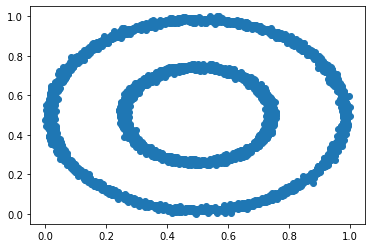

In [17]:
#collapse-hide
data, _ = make_circles(n_samples=5000, factor=0.5, noise=0.015, random_state=0)

# 前処理
scaler = MinMaxScaler()
train_data = scaler.fit_transform(data)

# プロット
plt.scatter(train_data[:,0], train_data[:,1])

# 学習用のデータローダ
train_tensor = torch.from_numpy(train_data.astype("float32"))
train_dataset = torch.utils.data.TensorDataset(train_tensor)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=64, shuffle=True)

# テストデータ
n = 50
arr = np.linspace(0.0, 1.0,n)
m1,m2 = np.meshgrid(arr,arr)
test_data = np.hstack([m1.reshape(n**2,1), m2.reshape(n**2,1)])
test_tensor = torch.from_numpy(test_data.astype("float32")).to(device)

## モデル構成

In [7]:
class NN(nn.Module):
  def __init__(self):
    super().__init__()
    self.net = nn.Sequential(
        nn.Linear(2, 64),
        nn.SiLU(),
        nn.Linear(64, 64),
        nn.SiLU(),
        nn.Linear(64, 64)
    )

  def forward(self, x):
    output = self.net(x).sum(axis=1)
    return output

## 誤差関数

In [8]:
def loss_func(x, energy):
  
    # 一階微分
    first_diff, = torch.autograd.grad(-energy, x, 
                                      grad_outputs = torch.ones_like(energy),
                                      create_graph = True)

    # 二階微分
    second_diff = torch.autograd.grad(first_diff, x,
                                      grad_outputs = torch.ones_like(first_diff),
                                      create_graph = True)[0]
  
    return (first_diff**2 + 2 * second_diff).sum(axis=1).mean()

In [9]:
# モデル
model = NN().to(device)

# 学習のログ
loss_log = []
energy_log = []
data_energy_log = []

# 最適化法
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

## 推定実行

In [10]:
epoch = 3000
for e in range(1, epoch+1):

    size = len(train_loader.dataset)
    loss_sum = 0
    
    for sample, in train_loader:
      
        # 入力データのセッティング
        sample = sample.to(device)
        sample.requires_grad = True
        energy = model(sample)
        loss = loss_func(sample, energy)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        loss_sum += loss.data

    loss_log.append(loss_sum/size)

    if e % 10 == 0:
        print("epoch : {}/{}, loss : {}".format(e, epoch, sum(loss_log[-100:])/100))

        model.eval()
        energy = model(test_tensor).to('cpu').detach().numpy()
        energy_log.append(energy)

        data_energy = model(sample).to('cpu').detach().numpy()
        data_energy_log.append(data_energy)

epoch : 10/3000, loss : -0.08338470011949539
epoch : 20/3000, loss : -0.2878255546092987
epoch : 30/3000, loss : -2.2863991260528564
epoch : 40/3000, loss : -8.685164451599121
epoch : 50/3000, loss : -17.223005294799805
epoch : 60/3000, loss : -26.482295989990234
epoch : 70/3000, loss : -36.1797981262207
epoch : 80/3000, loss : -46.20315170288086
epoch : 90/3000, loss : -56.48970413208008
epoch : 100/3000, loss : -66.90300750732422
epoch : 110/3000, loss : -77.89024353027344
epoch : 120/3000, loss : -89.7041015625
epoch : 130/3000, loss : -100.77731323242188
epoch : 140/3000, loss : -108.42050170898438
epoch : 150/3000, loss : -114.95436096191406
epoch : 160/3000, loss : -121.60564422607422
epoch : 170/3000, loss : -128.74969482421875
epoch : 180/3000, loss : -136.35435485839844
epoch : 190/3000, loss : -144.29281616210938
epoch : 200/3000, loss : -152.6133575439453
epoch : 210/3000, loss : -161.01644897460938
epoch : 220/3000, loss : -168.96641540527344
epoch : 230/3000, loss : -176.6

epoch : 1860/3000, loss : -411.8584289550781
epoch : 1870/3000, loss : -412.77740478515625
epoch : 1880/3000, loss : -413.2086181640625
epoch : 1890/3000, loss : -412.680419921875
epoch : 1900/3000, loss : -412.8074951171875
epoch : 1910/3000, loss : -413.00616455078125
epoch : 1920/3000, loss : -413.2409362792969
epoch : 1930/3000, loss : -413.5752258300781
epoch : 1940/3000, loss : -413.72064208984375
epoch : 1950/3000, loss : -413.9647216796875
epoch : 1960/3000, loss : -414.7547607421875
epoch : 1970/3000, loss : -414.3896484375
epoch : 1980/3000, loss : -413.8370361328125
epoch : 1990/3000, loss : -414.6212463378906
epoch : 2000/3000, loss : -414.61126708984375
epoch : 2010/3000, loss : -414.7867431640625
epoch : 2020/3000, loss : -414.51971435546875
epoch : 2030/3000, loss : -414.26593017578125
epoch : 2040/3000, loss : -414.1272277832031
epoch : 2050/3000, loss : -414.3841552734375
epoch : 2060/3000, loss : -414.2296447753906
epoch : 2070/3000, loss : -414.61236572265625
epoch :

## 可視化

/tmp/ipykernel_24230/1371740217.py:3: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


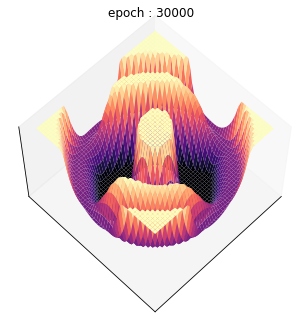

In [16]:
plt.rcParams["animation.embed_limit"] = 30.0
fig = plt.figure()
ax = Axes3D(fig)
ax.view_init(elev=60, azim=45)

def update(frame):
    ax.cla()
    f_energy = energy_log[frame]
    c = np.percentile(f_energy, q=[20, 80, 90])
    f_energy = np.clip(f_energy, c[0], c[1])
    ax.plot_surface(m1, m2, f_energy.reshape(n,n), cmap="magma")
    ax.set_zlim(c[0], c[1])
    #ax.scatter3D(train_data[:,0], train_data[:,1])
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.set_title("epoch : {}".format((frame+1)*100))

anim = FuncAnimation(fig, update, frames=len(energy_log), interval=50)
anim